In [1]:
# imports

import re
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

%matplotlib inline

In [2]:
class Celestial_Object():
    def __init__(self, file_name):
        
        G = 6.67430e-11 / (1000)**3   # km^3 kg^-1 s^-2
        check = 0
        with open(file_name) as f:
            lines=f.readlines()
            for i in range(len(lines)):
                line = lines[i]

                if("Target body name:" in line):
                    self.name = line.split()[3]
                elif(("GM," in line and check == 0) or 
                     ("GM " in line and check == 0) or
                     ("GM=" in line and check == 0)):
                    check = 1
                    line = re.sub(r"^.*?GM", "GM", line)
                    for c in line.split():
                        c = c.replace("+-", "")
                        try:
                            GM = float(c)
                            break
                        except ValueError:
                            continue
                        
                    self.mass = GM/G
                elif("$$SOE" in line):
                    pos_i = i + 2
                    vel_i = i + 3
                    break
        
            pos_data = lines[pos_i].split(sep = "=")[1:]
            vel_data = lines[vel_i].split(sep = "=")[1:]

            replacements = [(" ", ""), ("Y", ""), ("Z", ""), 
                            ("\n", ""), ("V", "")]
            
            out_list = []
            for arr in [pos_data, vel_data]:
                for j in range(len(arr)):
                    for char, replacement in replacements:
                        if char in arr[j]:
                            arr[j] = arr[j].replace(char, replacement)

                out_list.append(arr)

            pos_data, vel_data = out_list

            self.r_0 = np.array(list(map(float, pos_data)))*1000   # m
            self.v_0 = np.array(list(map(float, vel_data)))*1000   # m/s

In [3]:
class Solar_System():
    def __init__(self, objects, t_0, t_f, delta_t):
        
        self.G = 6.67430e-11
        self.objects = objects
        self.delta_t = delta_t

        self.initialize(t_0, t_f)
   
    def initialize(self, t_0, t_f):
        self.n = int(np.ceil((t_f-t_0)/self.delta_t))
        self.t = np.zeros(self.n)
        self.r_arrays = {}
        self.v_arrays = {}
        
        for object in self.objects:
            self.r_arrays["{0}".format(object.name)] = np.zeros((self.n,3))
            self.v_arrays["{0}".format(object.name)] = np.zeros((self.n,3))
     
            self.r_arrays["{0}".format(object.name)][0] = object.r_0
            self.v_arrays["{0}".format(object.name)][0] = object.v_0
              
    def Velocity_Verlet(self):
        for j in range(self.n-1):
            a = self.acceleration(j, self.r_arrays)
            next_r = self.position(j, self.delta_t, self.r_arrays, self.v_arrays, a)
            for key in self.r_arrays.keys():
                self.r_arrays[key][j+1] = next_r[key]
            a_next = self.acceleration(j+1, self.r_arrays)
            comb_a = {}
            for key in a_next.keys():
                comb_a[key] = a[key] + a_next[key]
            next_v = self.velocity(j, self.delta_t, self.v_arrays, comb_a)
            for key in self.r_arrays.keys():
                self.v_arrays[key][j+1] = next_v[key]
            self.t[j+1] = self.t[j] + self.delta_t
    
    def RK4(self):
        for j in range(self.n-1):
            key_list = self.r_arrays.keys()
            r_step = {}
            v_step = {}
            r_next = {}
            for key in key_list:
                r_step[key] = self.r_arrays[key][j]
                v_step[key] = self.v_arrays[key][j]
            
            rk1 = {}
            rk2 = {}
            rk3 = {}
            rk4 = {}
            
            vk1 = {}
            vk2 = {}
            vk3 = {}
            vk4 = {}

            ######################################################################
            # STEP 1

            vk1 = self.acceleration(None, r_step)
            rk1 = v_step

            ######################################################################
            # STEP 2

            for key in key_list:
                r_next[key] = r_step[key] + rk1[key]*self.delta_t/2
                rk2[key] = v_step[key] + vk1[key]*self.delta_t/2

            vk2 = self.acceleration(None, r_next)    


            ######################################################################
            # STEP 3

            for key in key_list:
                r_next[key] = r_step[key] + rk2[key]*self.delta_t/2
                rk3[key] = v_step[key] + vk2[key]*self.delta_t/2

            vk3 = self.acceleration(None, r_next)

            ######################################################################
            # STEP 4

            for key in key_list:
                r_next[key] = r_step[key] + rk3[key]*self.delta_t
                rk4[key] = v_step[key] + vk3[key]*self.delta_t

            vk4 = self.acceleration(None, r_next)
            
            ######################################################################
            # SOLVE NEXT VALUES

            for key in key_list:
                self.r_arrays[key][j+1] = r_step[key] + (self.delta_t/6)*(rk1[key] + 2*rk2[key] + 2*rk3[key] + rk4[key])
                self.v_arrays[key][j+1] = v_step[key] + (self.delta_t/6)*(vk1[key] + 2*vk2[key] + 2*vk3[key] + vk4[key])

            self.t[j+1] = self.t[j] + self.delta_t

            ######################################################################

    def force(self, mass, r0, r1):
        r_diff = r1 - r0
        rmag = np.linalg.norm(r_diff)
        a = (-self.G*mass*r_diff)/(rmag**3)
        return a

    def position(self, j, h, r, v, a):
        r_next = {}
        if j == None:
            for key in self.r_arrays.keys():
                r_next[key] = r[key] + h*v[key] + 0.5*(h**2)*a[key]
        else:
            for key in self.r_arrays.keys():
                r_next[key] = r[key][j] + h*v[key][j] + 0.5*(h**2)*a[key]
        return r_next
                        
    def velocity(self, j, h, v, a):
        v_next = {}
        if j == None:
            for key in self.v_arrays.keys():
                v_next[key] = v[key] + 0.5*h*a[key]
        else:
            for key in self.v_arrays.keys():
                v_next[key] = v[key][j] + 0.5*h*a[key]
        return v_next
    
    def acceleration(self, j, r):
        a_curr = {}
        for key in self.r_arrays.keys():
            a = 0
            for o in self.objects:
                call = o.name
                if call != key:
                    if j == None:
                        a += self.force(o.mass, r[call], r[key])
                    else:
                        a += self.force(o.mass, r[call][j], r[key][j])

            a_curr[key] = a
        return a_curr

In [4]:
object_dict = {}

pathlist = Path("object_data/major_planets").glob('*')
for path in pathlist:
    path_str = str(path)
    object = Celestial_Object(path_str)  
    object_dict[object.name] = object
    print(object.name, object.mass)

sorted_objects = dict(sorted(object_dict.items(), key = lambda item: np.linalg.norm(item[1].r_0)))

object_arr = np.array(list((sorted_objects.values())))

Earth 5.972168398723463e+24
Jupiter 1.8981246258034555e+27
Mars 6.416908921385016e+23
Mercury 3.301000636770898e+23
Neptune 1.0240924096909041e+26
Saturn 5.683173701212113e+26
Sun 1.9884098713264222e+30
Uranus 8.680987153709004e+25
Venus 4.867305814842006e+24


In [5]:
'''The following simulates solar system starting on Jan 1st 2000'''

#Creating the Solar System object
SolarSys = Solar_System(object_arr, t_0 = 0, t_f = (100)*(365*24*3600), delta_t = 2*(3600*24))

#Runs Velocity Verlet Numerical Method
#SolarSys.Velocity_Verlet()
SolarSys.RK4()

(-1.5, 1.5)

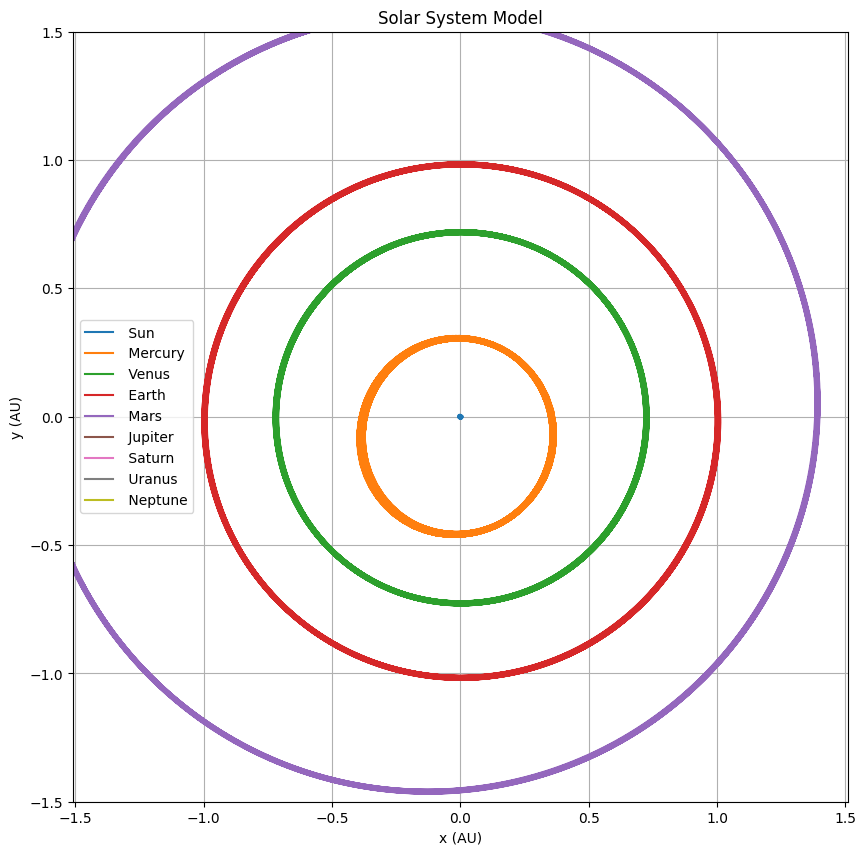

In [6]:
AU = 1.495978707e11   # m

plt.figure(figsize=(10,10))

for object in object_arr:
    name = object.name
    plt.plot(SolarSys.r_arrays[name][:,0]/AU, SolarSys.r_arrays[name][:,1]/AU, label = " "+name)

plt.title("Solar System Model")
plt.xlabel("x (AU)")
plt.ylabel("y (AU)")

plt.legend()
plt.axis('equal')
plt.grid()

high = 1.5
low = -1*high
plt.xlim(low, high)
plt.ylim(low, high)

In [7]:
'''Testing plotly interactive 3D plot'''

import plotly
import plotly.graph_objs as go

# Configure Plotly to be rendered inline in the notebook.
plotly.offline.init_notebook_mode()

data = []

for planet in object_arr:
    name = planet.name

    # Configure the trace.
    trace = go.Scatter3d(
        x = SolarSys.r_arrays[name][:,0]/AU,
        y = SolarSys.r_arrays[name][:,1]/AU,
        z = SolarSys.r_arrays[name][:,2]/AU,
        marker = {'size': 0.1},
        line = {'width': 2},
        name = name)

    data.append(trace)

# Configure the layout.
layout = go.Layout(margin = {'l': 0, 'r': 0, 'b': 0, 't': 0}, 
                   scene = dict(aspectmode = 'cube',
                                xaxis={'range':[-2,2]},
                                yaxis={'range':[-2,2]},
                                zaxis={'range':[-0.5,0.5]}))
plot_figure = go.Figure(data = data, layout = layout)

# Render the plot.
plotly.offline.iplot(plot_figure)